# Workaround Example for Cleaning Residual 1/f Noise in NIRSpec MOS Products
--------------------------------------------------------------------------------------------------------
**Latest update**: August 22, 2023.

## Notebook Goals
Produce a cleaned rate file to use as input for the level 2 and 3 pipelines.

## Introduction

This workaround is intended to address a known issue with NIRSpec pipeline products: negative and/or surplus flux in the extracted 1-D spectrum is seen, typically with an irregular wavelength-dependent undulation. The cause of this artifact is correlated noise from low-level detector thermal instabilities, seen as vertical banding in 2-D count rate images, particularly in exposures of the NRS2 detector. While the IRS2 readout mode reduces this effect, it is not completely eliminated.

This workaround uses an external package, developed by Bernard Rauscher, called [NSClean](https://webb.nasa.gov/content/forScientists/publications.html#NSClean), which uses dark areas of the detector to fit a background model to the data in Fourier space.  It requires an input mask to identify all dark areas of the detector. The more thorough and complete this mask is, the better the background fit.  In this notebook, we will use some metadata from a partially processed data product to automatically create a mask.  In some cases, this mask may not be complete enough for the best possible noise removal.  If needed, see the NSClean documentation for some suggestions on manually creating a custom mask.

This notebook uses as an example an ERS observation from program 1345: a MOS observation from the CEERS program with filter F290LP and grating G395M.

Use this workaround until a residual cleaning algorithm is incorporated into the pipeline.

## Set up

Prior to running this notebook, you will need to install the JWST pipeline and an external package called NSClean, developed by B. Rauscher.

It is recommended to install these packages into a new environment.  For example, using Anaconda:

```
conda create -n nsclean python=3.11
conda activate nsclean
```

Then, the latest pipeline and supporting packages can be installed via pip:

```
pip install jwst matplotlib jupyter pandas
```

If you have not used the pipeline before, you may also need to set some environment variables for retrieving reference data from CRDS, following the pipeline [Quickstart Guide](https://jwst-pipeline.readthedocs.io/en/latest/getting_started/quickstart.html).

Finally, download the latest version of the [NSClean code](https://webb.nasa.gov/content/forScientists/publications.html#NSClean). Unpack the archive and install the contained code.

For the latest version at time of writing (NSClean v1.9), the archive contains a directory called `nsclean_1.9`. The code may be installed with:

```
pip install -e nsclean_1.9
```

After installing all required packages, restart the jupyter server from the nsclean environment and open this notebook.  The following import step should now succeed.

Import necessary packages.

In [1]:
import json
import logging
import os
import requests
import warnings

import numpy as np
from matplotlib import pyplot as plt
from astropy.io import fits
from astropy.stats import sigma_clipped_stats, sigma_clip

import nsclean
from jwst import datamodels
from jwst.datamodels import dqflags
from jwst.assign_wcs import AssignWcsStep, nirspec
from jwst.extract_2d.nirspec import offset_wcs
from jwst.msaflagopen import MSAFlagOpenStep
from jwst.pipeline.calwebb_spec2 import Spec2Pipeline

# hide all log and warning messages
logging.disable(logging.ERROR)
warnings.simplefilter('ignore', RuntimeWarning)

Define a function to download a named file via the MAST API. The function includes authentication logic, but this example uses public data, so no MAST API token is required.

In [2]:
def get_jwst_file(name, mast_api_token=None):
    """Retrieve a JWST data file from MAST archive."""
    mast_url = "https://mast.stsci.edu/api/v0.1/Download/file"
    params = dict(uri=f"mast:JWST/product/{name}")
    if mast_api_token:
        headers = dict(Authorization=f"token {mast_api_token}")
    else:
        headers = {}
    r = requests.get(mast_url, params=params, headers=headers, stream=True)
    r.raise_for_status()
    with open(name, "wb") as fobj:
        for chunk in r.iter_content(chunk_size=1024000):
            fobj.write(chunk)

Create a list of filenames. Download the data from MAST.

In [3]:
obs_ids = ['jw01345061001_07101_00003']
detectors = [1, 2]

# specify rate data products
rate_names = []
for obs_id in obs_ids:
    for detector in detectors:
        rate_names.append(f'{obs_id}_nrs{detector}_rate.fits')

# download all the FITS files and associated MSA files
msa_names = []
for name in rate_names:
    print(f'Downloading {name}')
    get_jwst_file(name)

    # retrieve the MSA file from the header in the downloaded file
    msa_name = fits.getval(name, 'MSAMETFL')
    if not os.path.isfile(msa_name):
        print(f'Downloading {msa_name}')
        get_jwst_file(msa_name)
    msa_names.append(msa_name)    

## Assign a WCS to the rate file

In order to identify dark regions of the detector, we will need to run the first couple steps of the stage 2 pipeline. These steps will associate a WCS with the data file, with information about which MSA shutters are open during the observation.

Run AssignWcsStep and MSAFlagOpenStep on the input data.

In [4]:
wcs_names = []
for rate_file in rate_names:
    # process rate data
    print(f'Processing {os.path.basename(rate_file)}...')
    result = AssignWcsStep.call(rate_file)
    result = MSAFlagOpenStep.call(result)

    # save to disk
    outname = rate_file.replace('rate', 'wcs')
    result.save(outname)
    print(f'Saved {os.path.basename(outname)}\n')

    wcs_names.append(outname)

Processing jw01345061001_07101_00003_nrs1_rate.fits...
Saved jw01345061001_07101_00003_nrs1_wcs.fits

Processing jw01345061001_07101_00003_nrs2_rate.fits...
Saved jw01345061001_07101_00003_nrs2_wcs.fits



## Create a mask from the WCS in the updated file

The goal in creating the mask is to identify (mark True) any pixel that is unilluminated.  Here, we mark the following detector areas:

- pixels designated as open slits for this MOS observation
- traces from failed-open MSA shutters
- 5-sigma outliers
- any pixel set to NaN in the rate data.

Create and save a mask identifying dark areas of the detector.

In [5]:
mask_names = []
sigma = 5.0
for rate_file, wcs_file in zip(rate_names, wcs_names):
    # copy SCI data from rate file
    with fits.open(rate_file) as hdul:
        rate_sci = hdul['SCI'].data.copy()

    # initialize mask with everything set to True
    mask = np.full(np.shape(rate_sci), True)
    
    # open wcs data as a datamodel to retrieve slit bounding boxes 
    # and DQ information
    with datamodels.open(wcs_file) as wcs_model:

        # find open slitlets and mark False in the mask
        slit2msa = wcs_model.meta.wcs.get_transform('slit_frame', 'msa_frame')
        for slit in slit2msa.slits:
            slit_wcs = nirspec.nrs_wcs_set_input(wcs_model, slit.name)
            xlo, xhi, ylo, yhi = offset_wcs(slit_wcs)
            
            mask[ylo:yhi, xlo:xhi] = False
        
        # find traces of failed open shutters and 
        # set them to False as well
        fail_open = np.where(wcs_model.dq & datamodels.dqflags.pixel['MSA_FAILED_OPEN'])  
        mask[fail_open] = False

    # find NaNs from the rate file
    # set them to 0 in the rate data and False in the mask
    is_nan = np.isnan(rate_sci)
    rate_sci[is_nan] = 0
    mask[is_nan] = False

    # ignore the entire fixed slit area:
    # set it to False in the mask
    mask[922:1116, :] = False

    # keep the left and right reference pixel columns
    mask[:, :5] = True
    mask[:, -5:] = True

    # get stats to flag outliers and ignore them in the mask
    _, med, sig = sigma_clipped_stats(rate_sci, mask=~mask, mask_value=0, sigma=5.0)
    outliers = np.where(rate_sci > med + sigma * sig)
    mask[outliers] = False

    # save the mask to disk
    outname = rate_file.replace('rate', 'mask')
    fits.writeto(outname, mask.astype(np.uint8), overwrite=True)
    print(f"Saved {outname}") 

    mask_names.append(outname)

Saved jw01345061001_07101_00003_nrs1_mask.fits
Saved jw01345061001_07101_00003_nrs2_mask.fits


## Verify the mask keeps only unilluminated data

Check the mask against the rate data to make sure it keeps only dark areas of the detector.

In this example, note that there are still some remaining illuminated areas, primarily due to transient artifacts.

Plot the rate data with masked areas blocked.

In [6]:
def plot_dark_data(rate_file, mask_file):
    fig, ax = plt.subplots(1, 3, figsize=(10, 5))
    plt.suptitle(f'Dark areas for {os.path.basename(rate_file)}')
    
    with fits.open(mask_file) as hdulist:
        mask = hdulist[0].data

    with fits.open(rate_file) as hdulist:
        sci = hdulist['SCI'].data

    masked_sci = sci.copy()
    masked_sci[mask == 0] = 0
    vmin = np.nanpercentile(masked_sci, 1)
    vmax = np.nanpercentile(masked_sci, 99)
    
    sci[np.isnan(sci)] = 0
    ax[0].imshow(sci, origin='lower', vmin=vmin, vmax=vmax)
    ax[0].set_title('Rate data')
    
    ax[1].imshow(mask, origin='lower', vmin=0, vmax=1)
    ax[1].set_title('Mask')
    
    ax[2].imshow(masked_sci, origin='lower', vmin=vmin, vmax=vmax)
    ax[2].set_title('Dark data')

    fig.tight_layout()

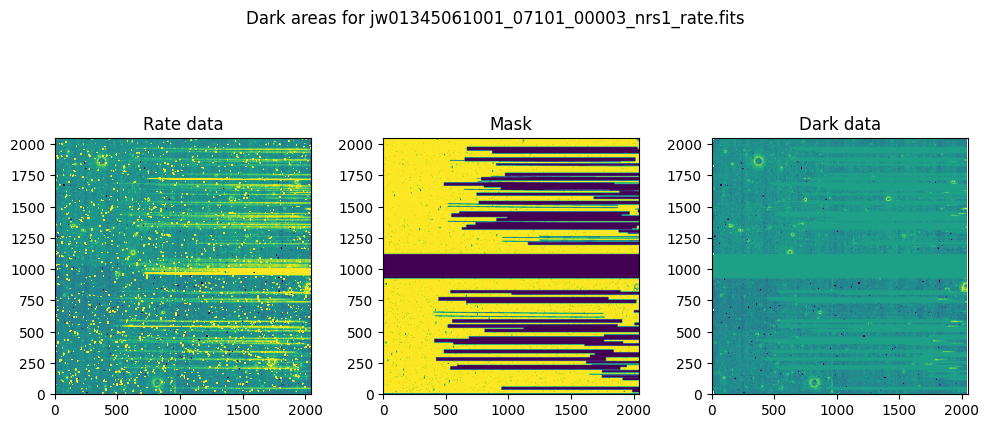

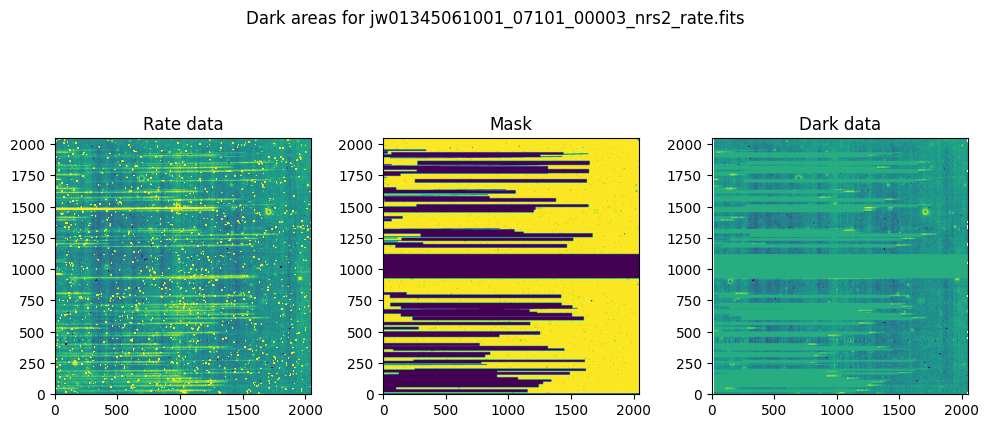

In [7]:
for rate_file, mask_file in zip(rate_names, mask_names):
    plot_dark_data(rate_file, mask_file)

## Use the mask to clean the rate data

We can use the NSClean package with the created mask to update the rate data, removing residual noise.

In some situations, the cleaning step may fail to find a fit to the background noise.  This may occur if the mask does not contain enough unilluminated data (marked True).  In particular, every column in the mask except for the first and last 4 columns must contain some pixels marked True.

For each file, instantiate the cleaner with the mask, then call the clean function.

In [8]:
def clean(rate_file, mask_file, suffix='rate_cleaned'):
    with fits.open(mask_file) as hdulist:
        mask = hdulist[0].data.astype(bool)

    rate_hdulist = fits.open(rate_file)
    sci = rate_hdulist['SCI'].data
    detector = rate_hdulist[0].header['DETECTOR']

    # set NaN values to zero
    is_nan = np.isnan(sci)
    sci[is_nan] = 0

    # instantiate the cleaner
    cleaner = nsclean.NSClean(detector, mask)

    # clean the data
    try:
        cleaned_sci = cleaner.clean(sci)
    except np.linalg.LinAlgError:
        print(f'Cannot clean {os.path.basename(rate_file)}')
        return None
    
    # restore NaNs
    cleaned_sci[is_nan] = np.nan  # restore NANs

    # save result
    rate_hdulist['SCI'].data = cleaned_sci

    outname = rate_file.replace('rate', suffix)
    rate_hdulist.writeto(outname, overwrite=True)
    rate_hdulist.close()
    print(f'Saved {os.path.basename(outname)}')
    
    return outname

In [9]:
cleaned_rate_names = []
for rate_file, mask_file in zip(rate_names, mask_names):
    outname = clean(rate_file, mask_file)
    cleaned_rate_names.append(outname)

Saved jw01345061001_07101_00003_nrs1_rate_cleaned.fits
Saved jw01345061001_07101_00003_nrs2_rate_cleaned.fits


## Check the cleaned data

We can now compare the cleaned data to the original rate file and verify that the noise has been removed.

In many cases, the cleaning process introduces new artifacts to the rate file.  These should be carefully examined and weighed against the benefits of the noise reduction.  If transient artifacts like snowballs are interfering with the cleaning process, it may be beneficial to manually edit the mask to remove these areas from consideration in the background fit. 

Plot the original and cleaned data, as well as a residual map.

In [10]:
def plot_cleaned_data(rate_file, cleaned_file):

    fig, ax = plt.subplots(2, 2, figsize=(10, 10))
    plt.suptitle(f'Cleaned data for {os.path.basename(rate_file)}')

    with fits.open(rate_file) as hdulist:
        original = hdulist['SCI'].data

    with fits.open(cleaned_file) as hdulist:
        cleaned = hdulist['SCI'].data

    vmin = np.nanpercentile(original, 1)
    vmax = np.nanpercentile(original, 99)
    
    original[np.isnan(original)] = 0
    cleaned[np.isnan(cleaned)] = 0
    ax[0, 0].imshow(original, origin='lower', vmin=vmin, vmax=vmax)
    ax[0, 0].set_title('Original rate data')
    
    ax[0, 1].imshow(cleaned, origin='lower', vmin=vmin, vmax=vmax)
    ax[0, 1].set_title('Cleaned rate data')

    diff = (original - cleaned) / original
    diff[~np.isfinite(diff)] = 0
    vmin = np.nanpercentile(diff, 1)
    vmax = np.nanpercentile(diff, 99)
    ax[1, 0].imshow(diff, origin='lower', vmin=vmin, vmax=vmax)
    ax[1, 0].set_title('Relative difference')

    hide_outliers = np.ma.filled(sigma_clip(diff, masked=True), fill_value=0)
    vmin = np.nanpercentile(hide_outliers, 1)
    vmax = np.nanpercentile(hide_outliers, 99)
    ax[1, 1].imshow(hide_outliers, origin='lower', vmin=vmin, vmax=vmax)
    ax[1, 1].set_title('Relative difference without outliers')

    fig.tight_layout()

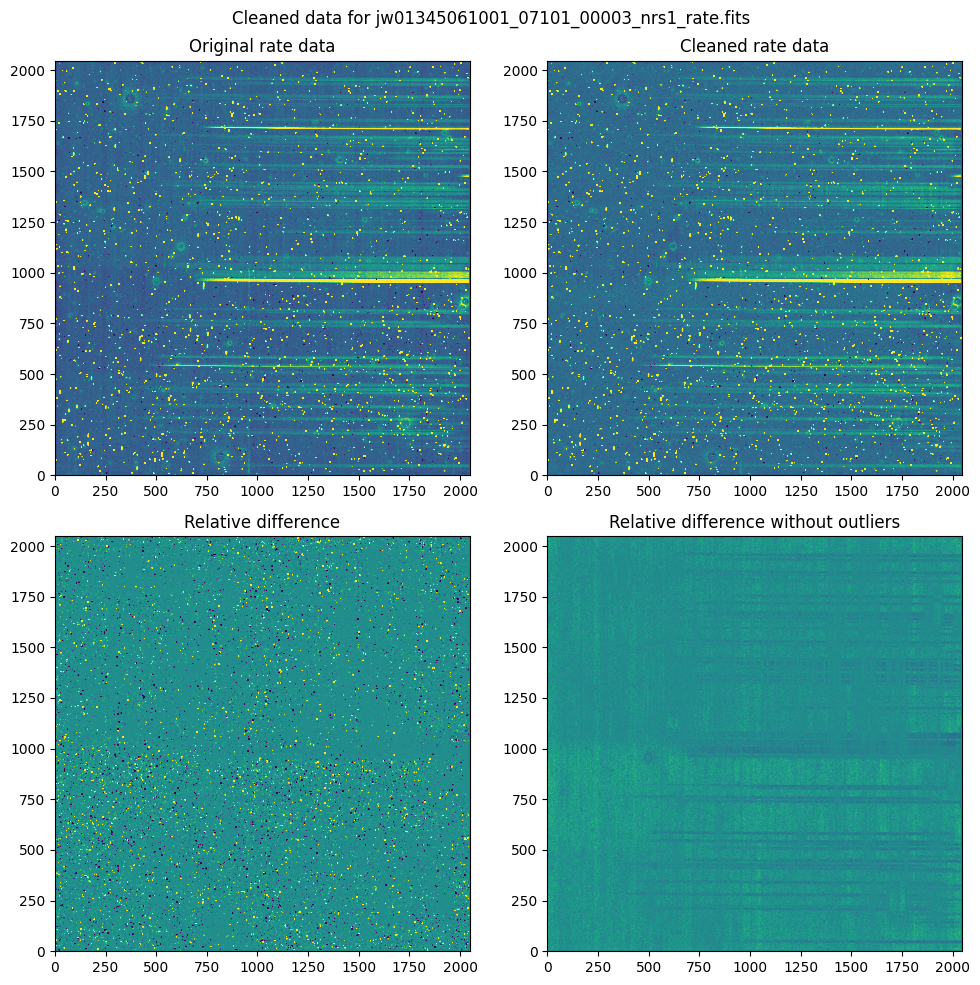

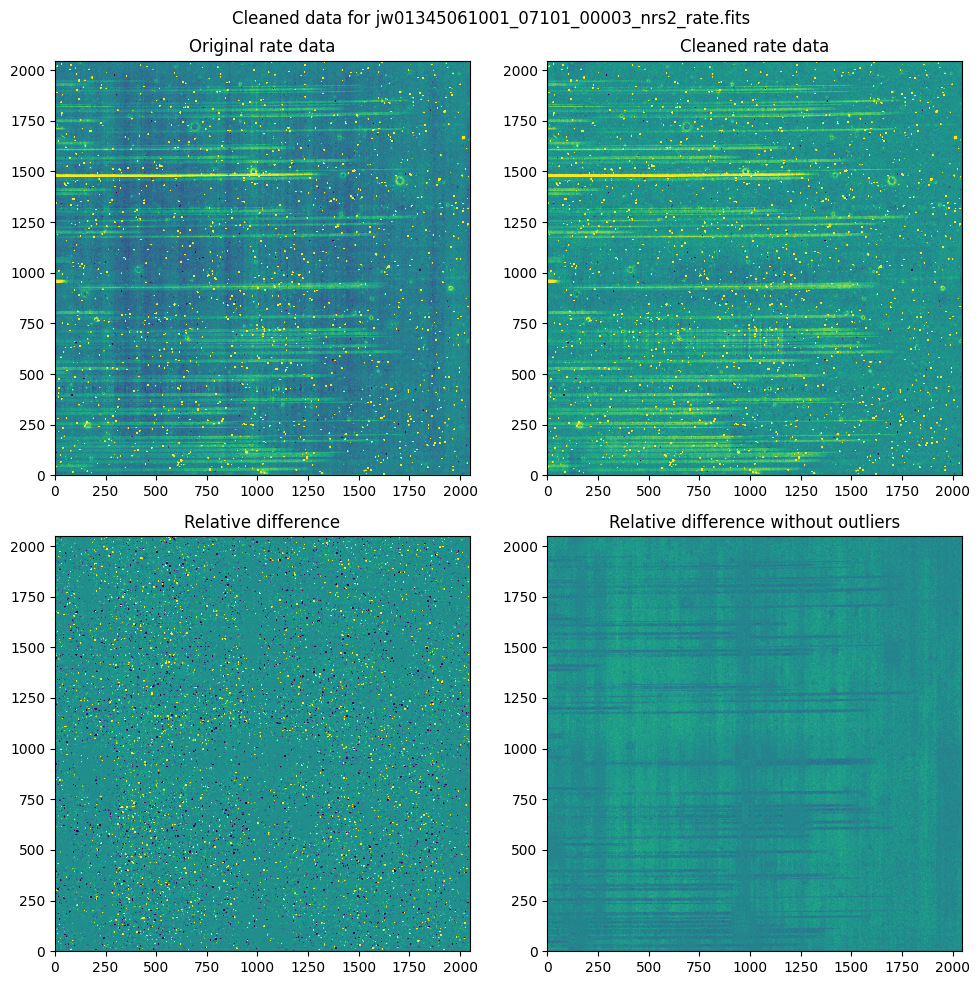

In [11]:
for rate_file, cleaned_file in zip(rate_names, cleaned_rate_names):
    if cleaned_file is None:
        continue
    plot_cleaned_data(rate_file, cleaned_file)

## Compare extracted spectra

We can now extract a spectrum from the cleaned data and compare it to the spectrum extracted from the original rate file.

In the results, note that in many spectra with low flux, the values are no longer negative and the continuum shape is corrected for wavelength-dependent undulations.  Also note that the cleaning process introduces additional low-level correlated noise, and that it may also introduce new artifacts to the spectra.

Run the spec2 pipeline on both sets of rate data. This will take some time to complete.

In [12]:
x1d_names = []
cleaned_x1d_names = []
for rate_file, cleaned_file in zip(rate_names, cleaned_rate_names):
    if cleaned_file is None:
        continue

    # original rate data
    print(f'Processing {os.path.basename(rate_file)}...')
    Spec2Pipeline.call(rate_file, save_results=True)
    x1d = rate_file.replace('rate', 'x1d')
    x1d_names.append(x1d)
    print(f'Saved {os.path.basename(x1d)}\n')
    
    # cleaned rate data
    print(f'Processing {os.path.basename(cleaned_file)}...')
    Spec2Pipeline.call(cleaned_file, save_results=True)
    x1d = cleaned_file.replace('rate_cleaned', 'rate_cleaned_x1d')
    cleaned_x1d_names.append(x1d)
    print(f'Saved {os.path.basename(x1d)}\n')

Processing jw01345061001_07101_00003_nrs1_rate.fits...
Saved jw01345061001_07101_00003_nrs1_x1d.fits

Processing jw01345061001_07101_00003_nrs1_rate_cleaned.fits...
Saved jw01345061001_07101_00003_nrs1_rate_cleaned_x1d.fits

Processing jw01345061001_07101_00003_nrs2_rate.fits...
Saved jw01345061001_07101_00003_nrs2_x1d.fits

Processing jw01345061001_07101_00003_nrs2_rate_cleaned.fits...
Saved jw01345061001_07101_00003_nrs2_rate_cleaned_x1d.fits



Plot both sets of spectra for each slit containing a point source.

In [13]:
def plot_spectra(original, cleaned, scale_percent=2.0, slit_id=None):

    original_hdul = fits.open(original)
    cleaned_hdul = fits.open(cleaned)

    for extnum in range(len(original_hdul)):
        hdu = original_hdul[extnum]
        if hdu.name != 'EXTRACT1D':
            continue

        # skip empty spectra and extended sources
        if hdu.header['SRCTYPE'] != 'POINT':
            continue
        if np.all(hdu.data['FLUX'] == 0):
            continue

        # plot the original and cleaned spectra together
        slit = hdu.header['SLTNAME']
        if slit_id is not None and slit != str(slit_id).strip():
            continue
        fig, ax = plt.subplots(1, 2, figsize=(10, 5))
        plt.suptitle(f'Compare spectra for {os.path.basename(original)}, slit={slit}')

        ax[0].plot(hdu.data['WAVELENGTH'], hdu.data['FLUX'],
                   linewidth=1, label=f"original")
        ax[0].plot(hdu.data['WAVELENGTH'], cleaned_hdul[extnum].data['FLUX'], 
                   linewidth=1, label=f"cleaned")
        ax[0].set_xlabel(f"Wavelength ({hdu.header['TUNIT1']})")
        ax[0].set_ylabel(f"Flux ({hdu.header['TUNIT2']})")
        ax[0].set_title(f"Spectra from slit {slit}")
        ax[0].legend()

        # plot the difference between the spectra
        diff = (cleaned_hdul[extnum].data['FLUX'] - hdu.data['FLUX'])
        ax[1].plot(hdu.data['WAVELENGTH'], diff, linewidth=1)
        ax[1].set_xlabel(f"Wavelength ({hdu.header['TUNIT1']})")
        ax[1].set_ylabel(f"Difference in flux ({hdu.header['TUNIT2']})")
        ax[1].set_title(f"Difference after cleaning, slit {slit}")

        # set all y ranges the same
        all_flux = [hdu.data['FLUX'], cleaned_hdul[extnum].data['FLUX']]
        y_range = [np.nanpercentile(all_flux, scale_percent), 
                   np.nanpercentile(all_flux, 100 - scale_percent)]
        y_range[0] = np.min([y_range[0], np.nanmin(diff)])
        y_range[1] = np.max([y_range[1], np.nanmax(diff)])
        ax[0].set_ylim(y_range)
        ax[1].set_ylim(y_range)
        
        fig.tight_layout()
    
    original_hdul.close()
    cleaned_hdul.close()

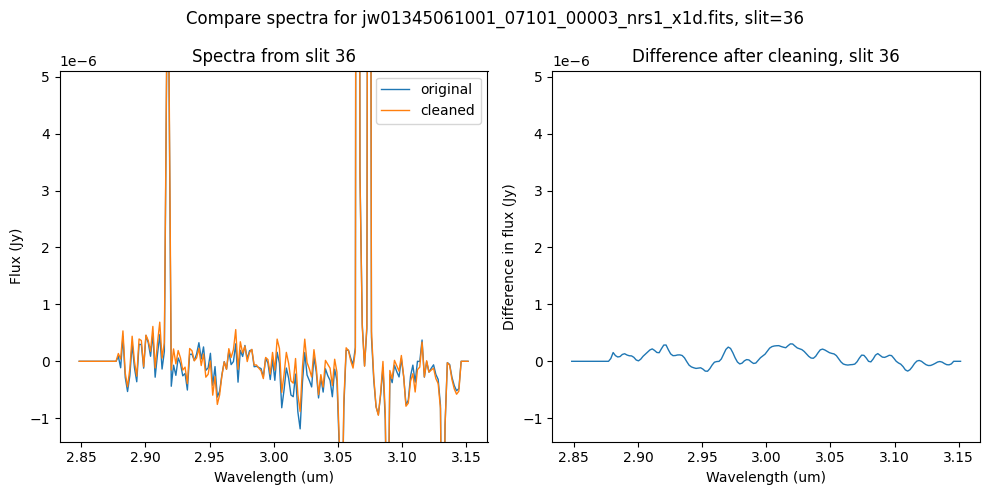

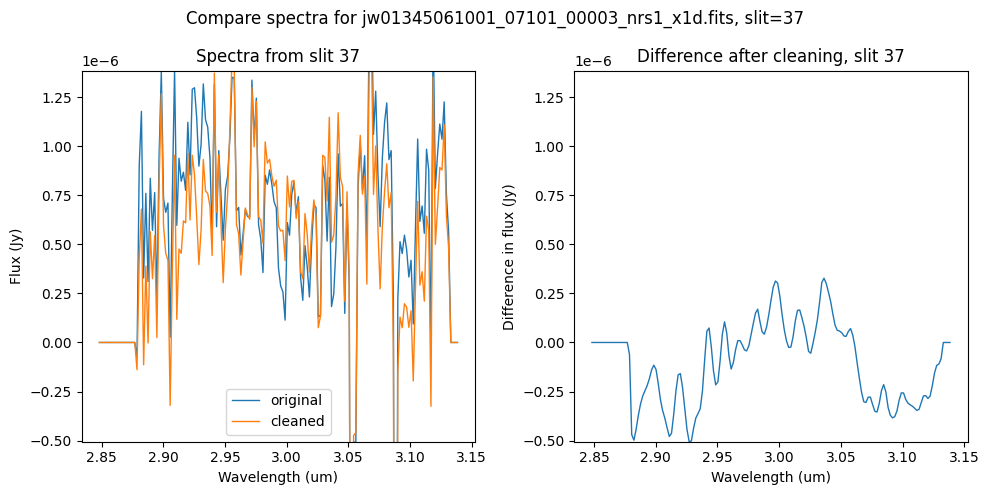

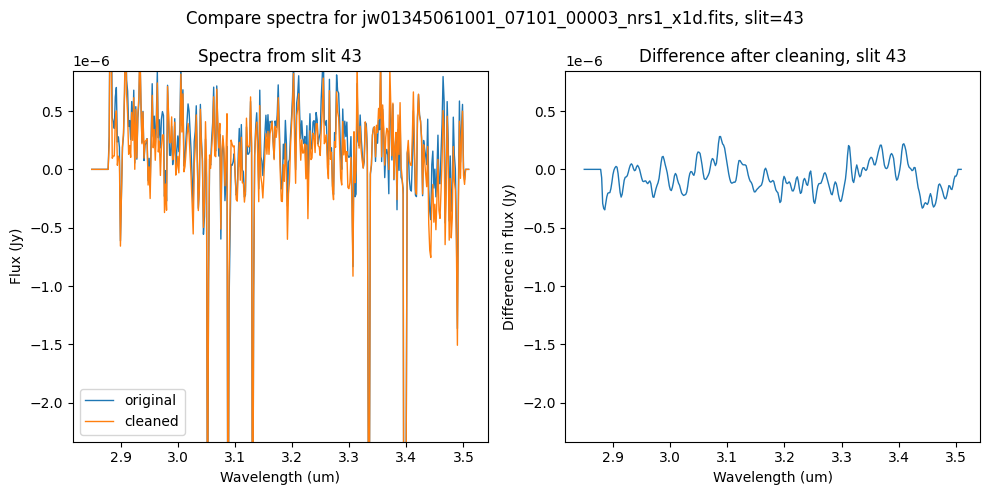

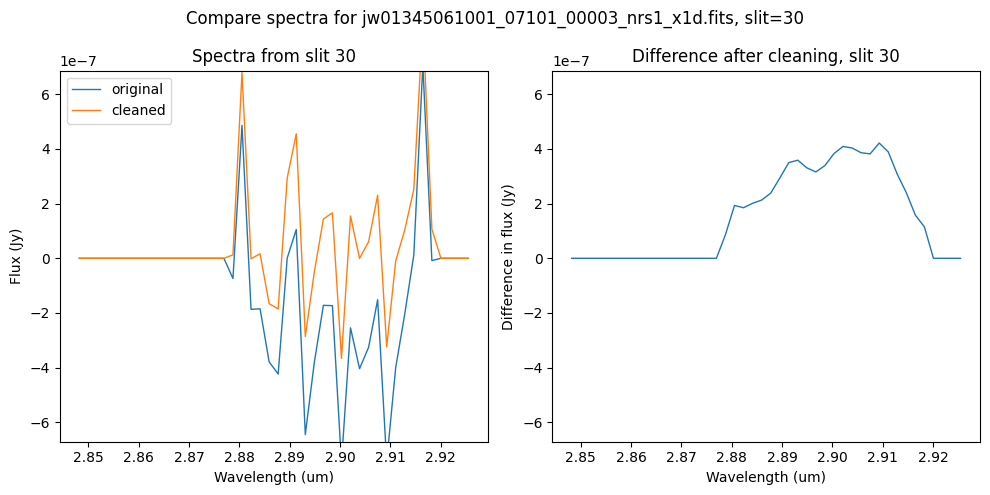

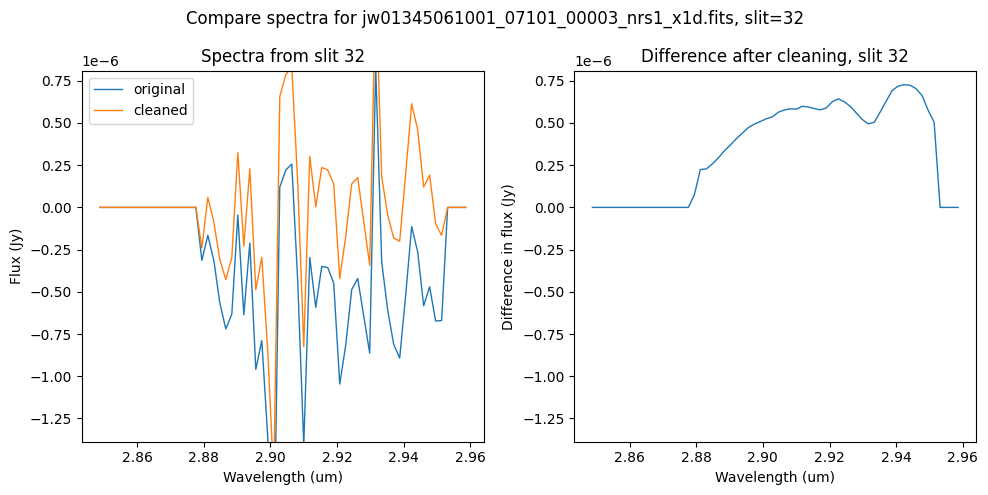

...

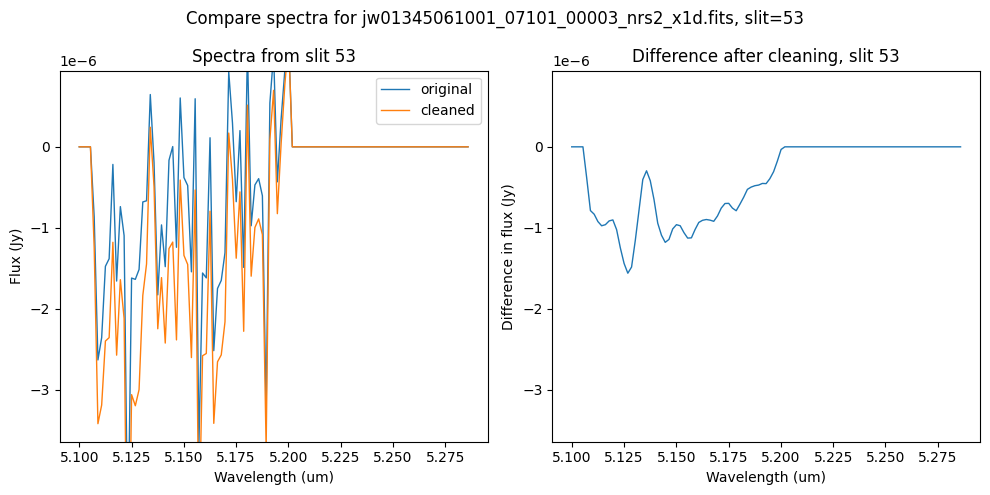

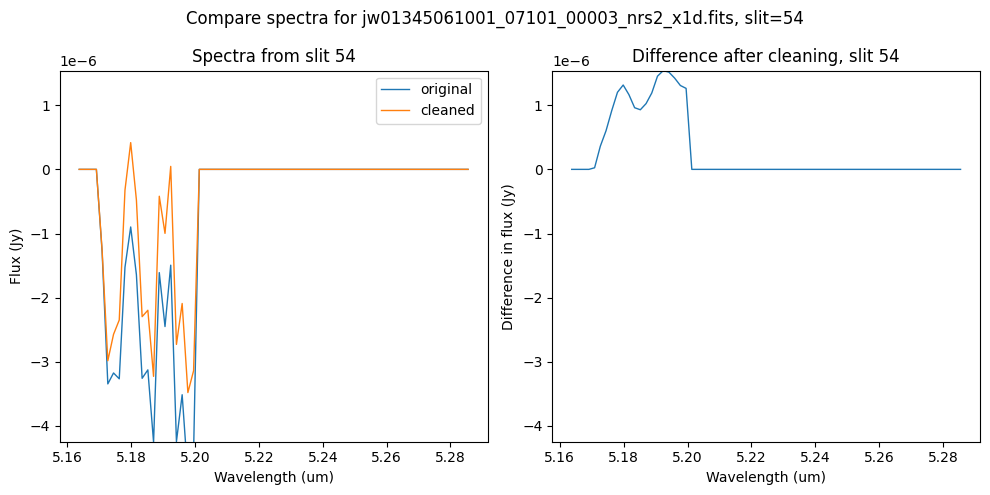

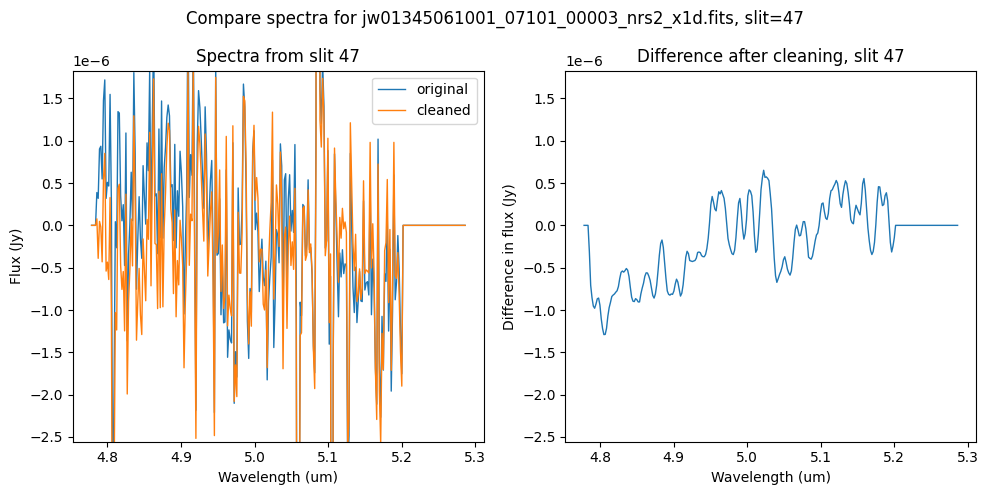

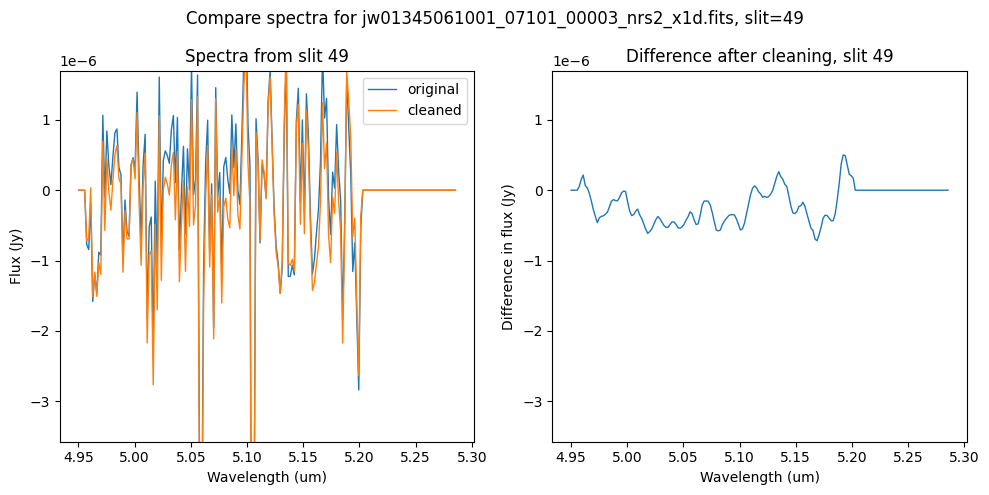

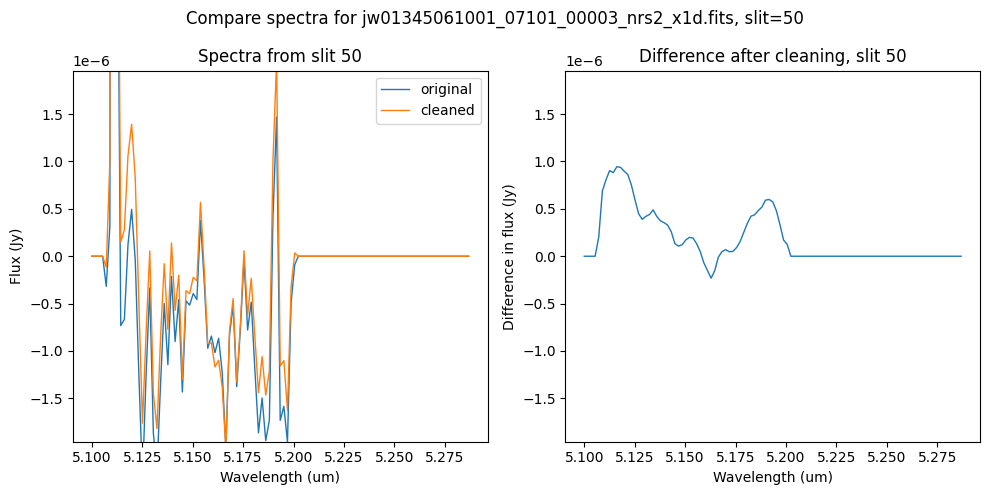

In [14]:
for original, cleaned in zip(x1d_names, cleaned_x1d_names):
    plot_spectra(original, cleaned)

## Alternate masking algorithm

For this data set, note that some regions of the detector are heavily masked, due to overlapping slit regions.  For example, see the cleaned rate data for NRS2 above, around x=1000, y=600.  

In this region, the cleaning process introduces some high frequency noise that appears as vertical striping over the spectral traces.  Slit 11 is extracted from this region, and shows a noticeable dip in the spectrum extracted from the cleaned data, compared to the original rate data (below).

Also note that for MOS data, there may be several illuminated regions of the detector that are not masked by the slitlet bounding boxes.  For the M gratings, zeroth-order spectra may appear on the detector, and are not easily located. For the long-pass filters, there is still some light past the red cutoff of the slitlet bounding box.

In this case, it may be beneficial to build the mask with an alternate algorithm.  Here, we do not use slitlet bounding boxes and instead mask any data more than 2 sigma above the background.  This leaves more dark data between the spectral traces and improves the background fit in the problematic area.

Plot the problematic spectrum from slit 11.

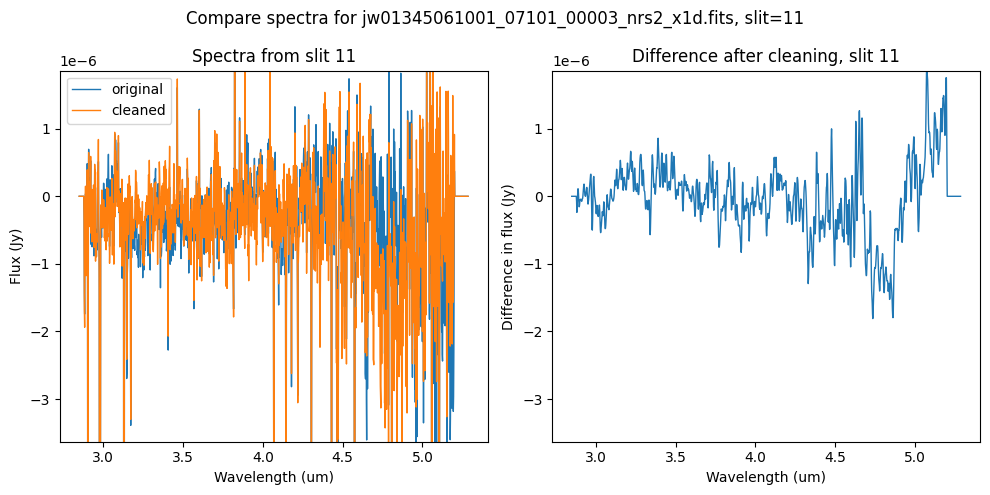

In [15]:
for original, cleaned in zip(x1d_names, cleaned_x1d_names):
    plot_spectra(original, cleaned, slit_id=11)

Create a new mask, clean the data, and re-extract a spectrum.

Saved jw01345061001_07101_00003_nrs1_mask_outliers.fits
Saved jw01345061001_07101_00003_nrs2_mask_outliers.fits


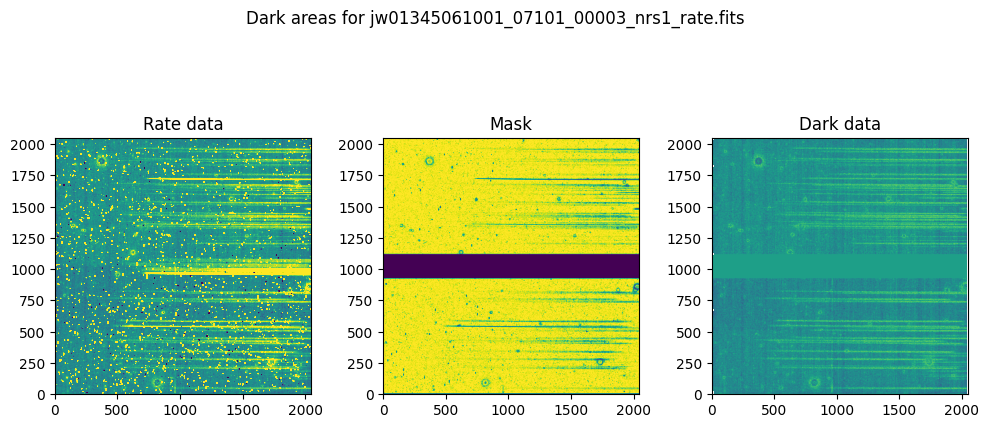

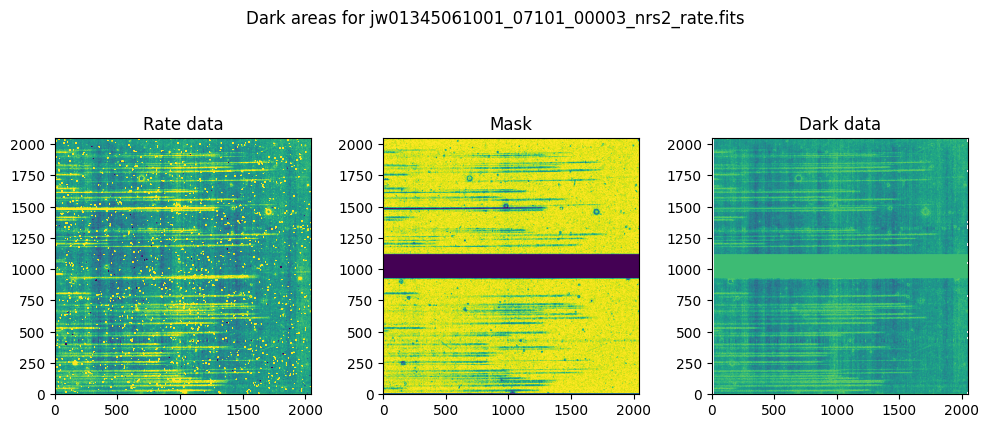

In [16]:
# make a new mask

outlier_mask_names = []
sigma = 2.0
for rate_file in rate_names:
    # copy SCI data from rate file
    with fits.open(rate_file) as hdul:
        rate_sci = hdul['SCI'].data.copy()

    # initialize mask with everything set to True
    mask = np.full(np.shape(rate_sci), True)
    
    # find NaNs from the rate file
    # set them to 0 in the rate data and False in the mask
    is_nan = np.isnan(rate_sci)
    rate_sci[is_nan] = 0
    mask[is_nan] = False

    # ignore the entire fixed slit area:
    # set it to False in the mask
    mask[922:1116, :] = False

    # keep the left and right reference pixel columns
    mask[:, :5] = True
    mask[:, -5:] = True

    # flag all data 2 sigma over the background level
    outliers = sigma_clip(rate_sci, masked=True, sigma_upper=sigma).mask
    mask[outliers] = False

    # save the mask to disk
    outname = rate_file.replace('rate', 'mask_outliers')
    fits.writeto(outname, mask.astype(np.uint8), overwrite=True)
    print(f"Saved {outname}") 

    outlier_mask_names.append(outname)

    # plot the mask and the remaining dark data
    plot_dark_data(rate_file, outname)

Saved jw01345061001_07101_00003_nrs1_rate_outlier_cleaned.fits
Saved jw01345061001_07101_00003_nrs2_rate_outlier_cleaned.fits


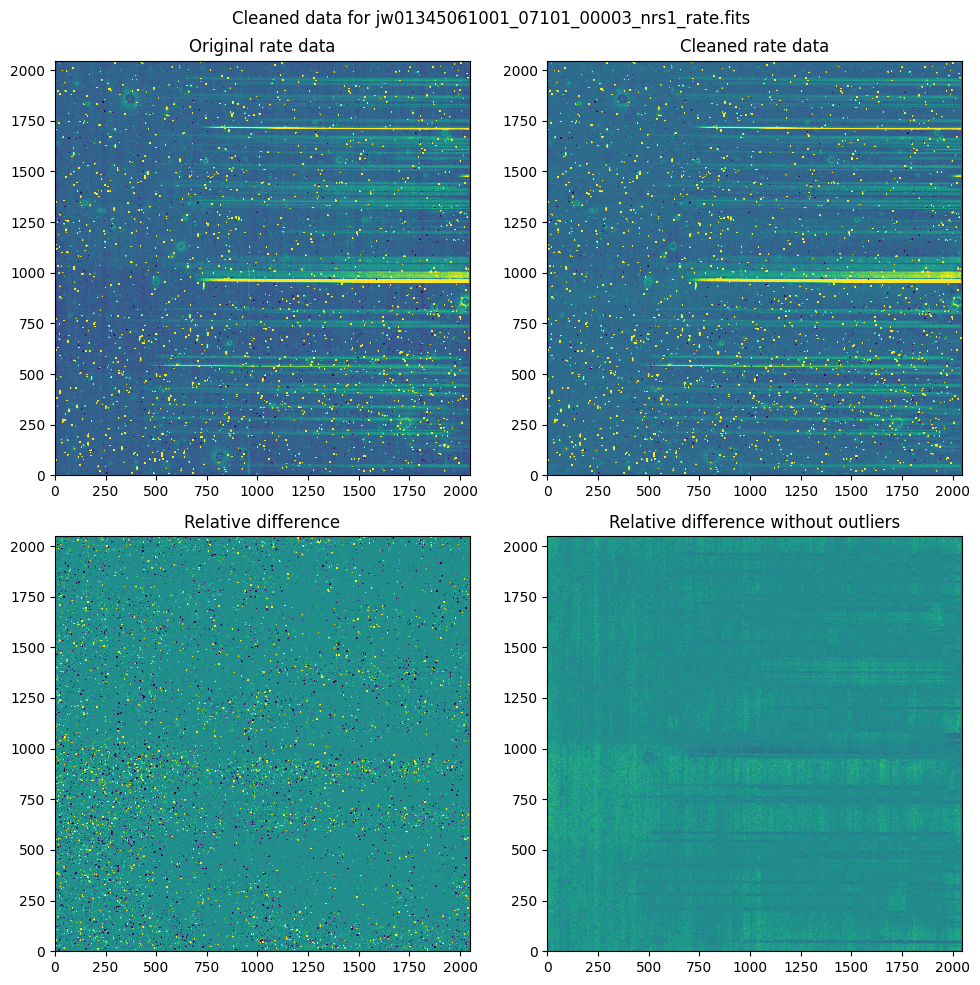

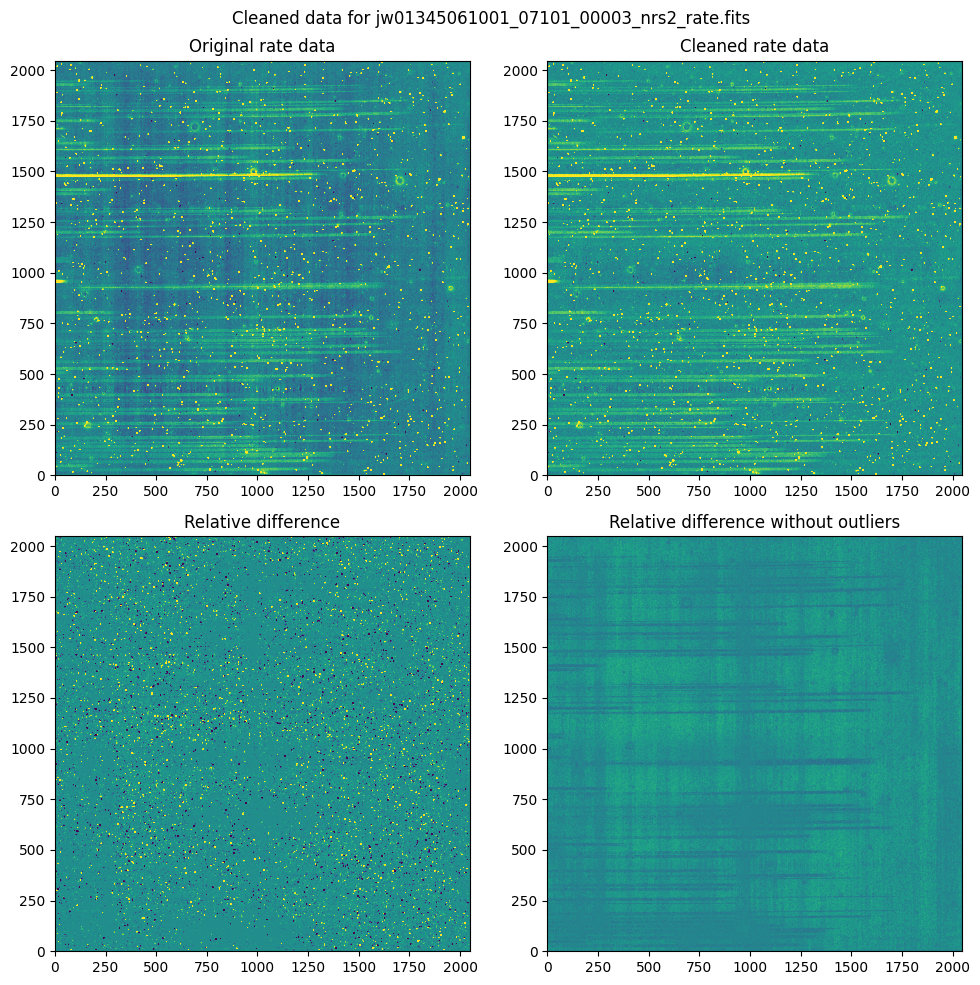

In [17]:
# clean the rate files with the new mask
outlier_cleaned_rate_names = []
for rate_file, mask_file in zip(rate_names, outlier_mask_names):
    outname = clean(rate_file, mask_file, suffix='rate_outlier_cleaned')
    outlier_cleaned_rate_names.append(outname)
    if outname is None:
        continue

    plot_cleaned_data(rate_file, outname)

In [18]:
# extract spectra from the new files
outlier_cleaned_x1d_names = []
for cleaned_file in outlier_cleaned_rate_names:
    if cleaned_file is None:
        continue
        
    # process cleaned rate data
    print(f'Processing {os.path.basename(cleaned_file)}...')
    Spec2Pipeline.call(cleaned_file, save_results=True)
    x1d = cleaned_file.replace('rate_outlier_cleaned', 'rate_outlier_cleaned_x1d')
    outlier_cleaned_x1d_names.append(x1d)
    print(f'Saved {os.path.basename(x1d)}\n')
    assert os.path.isfile(x1d)

Processing jw01345061001_07101_00003_nrs1_rate_outlier_cleaned.fits...
Saved jw01345061001_07101_00003_nrs1_rate_outlier_cleaned_x1d.fits

Processing jw01345061001_07101_00003_nrs2_rate_outlier_cleaned.fits...
Saved jw01345061001_07101_00003_nrs2_rate_outlier_cleaned_x1d.fits



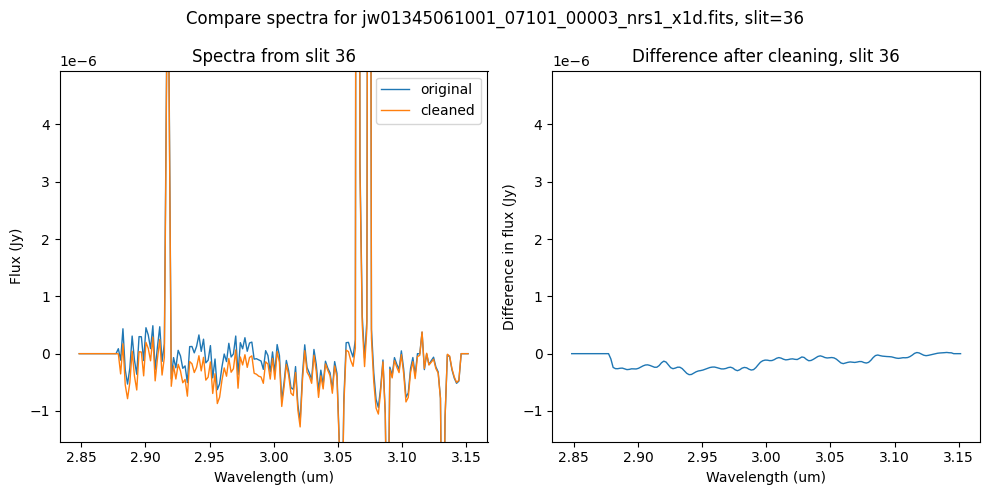

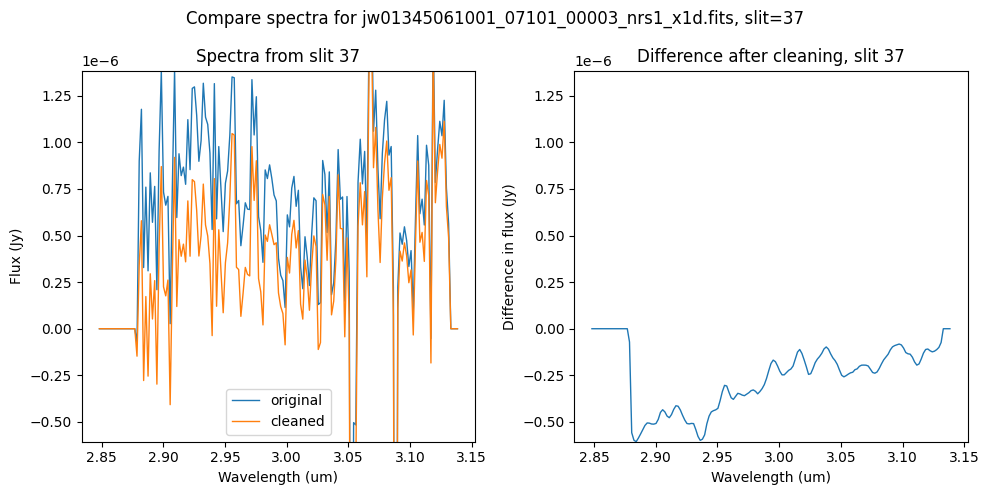

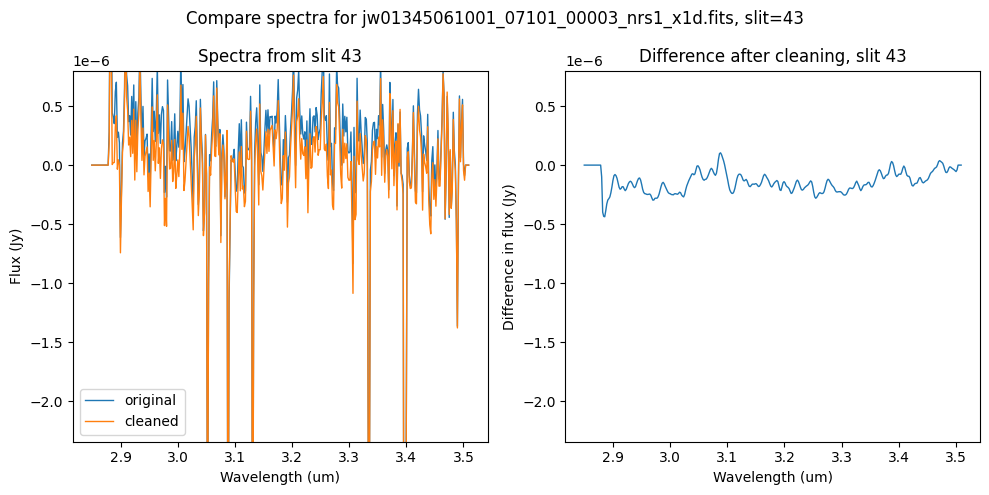

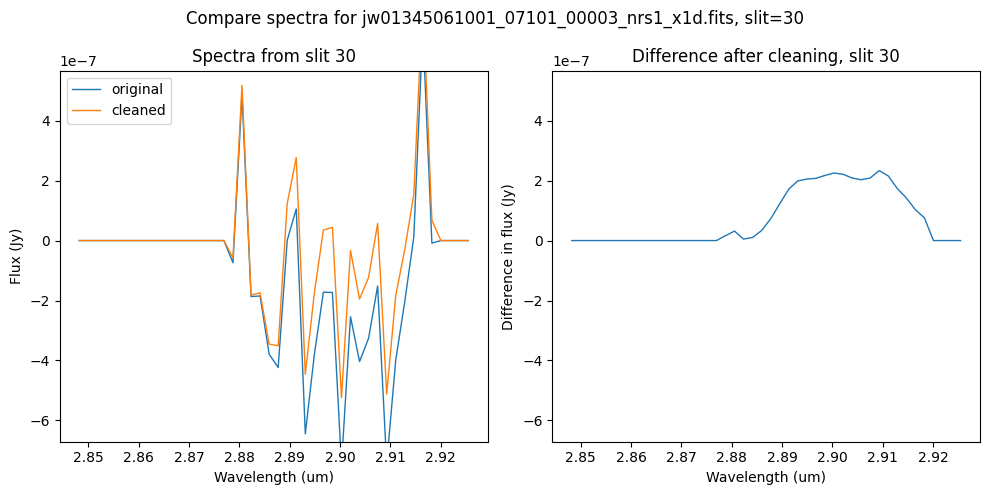

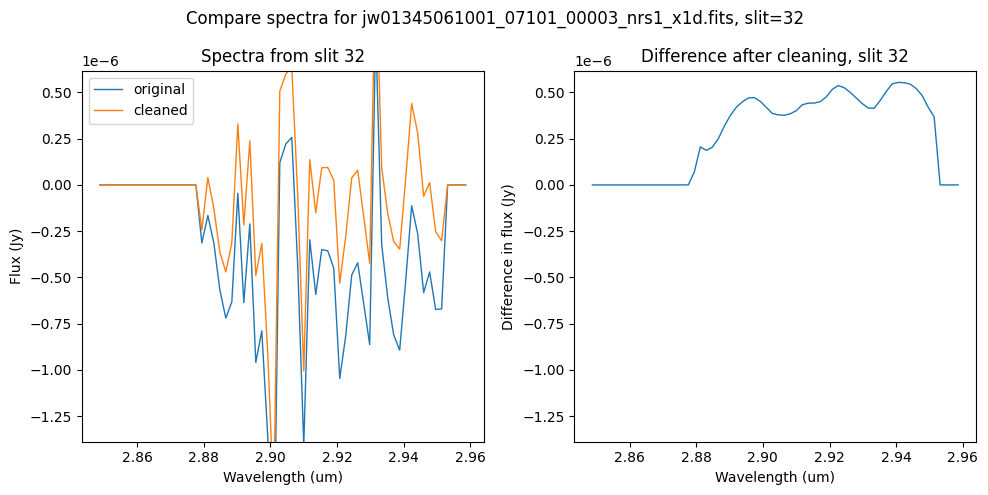

...

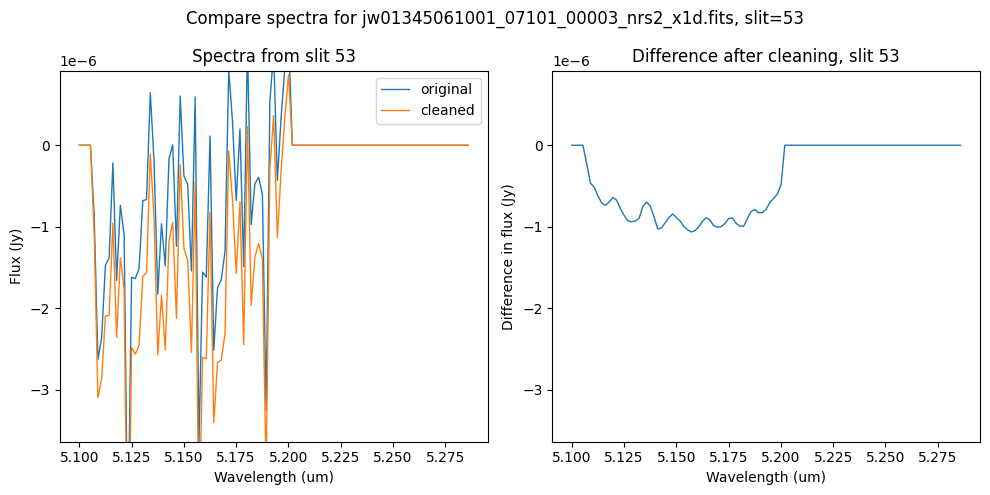

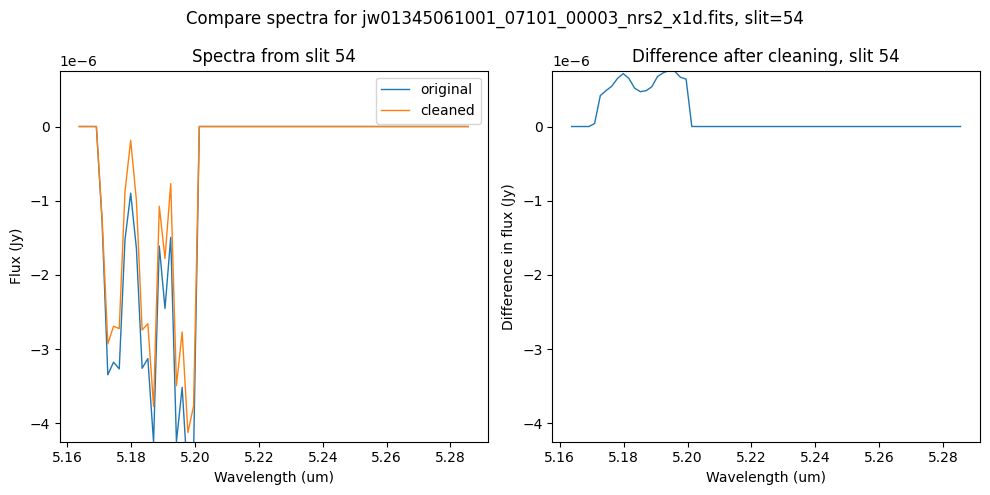

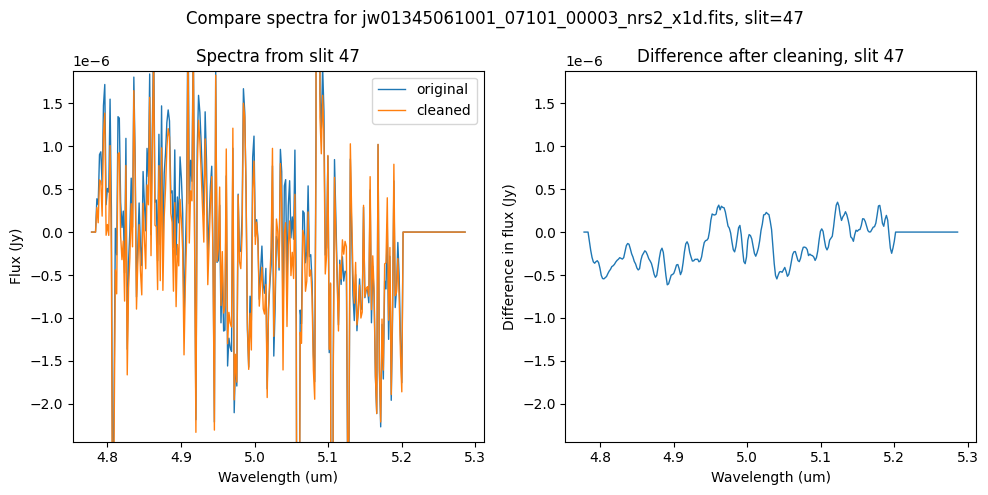

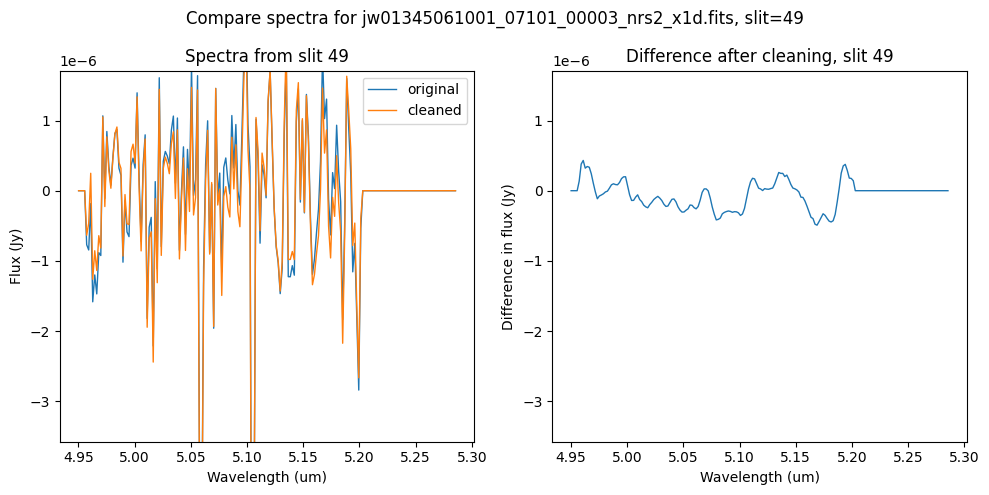

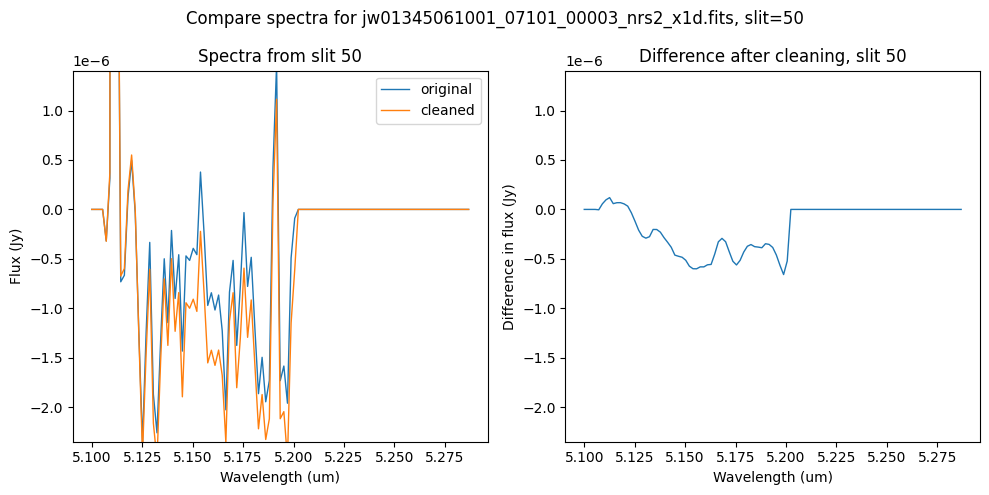

In [19]:
for original, cleaned in zip(x1d_names, outlier_cleaned_x1d_names):
    plot_spectra(original, cleaned)

Note that the high frequency noise in NRS2 no longer appears and the spectrum for slit 11 is much improved.

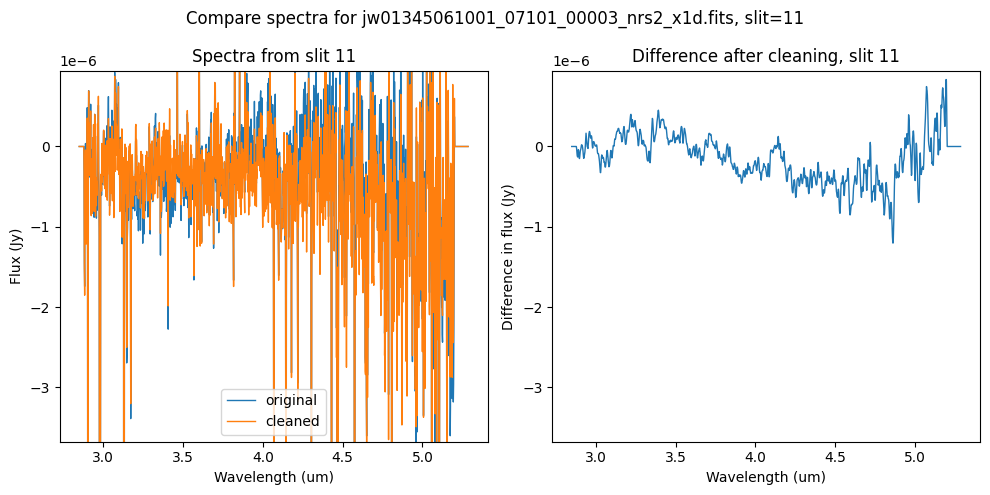

In [20]:
for original, cleaned in zip(x1d_names, outlier_cleaned_x1d_names):
    plot_spectra(original, cleaned, slit_id=11)